In [ ]:
import numpy as np
import pandas as pd
import cv2 as cv 
from google.colab.patches import cv2_imshow # for image display
from skimage import io
from PIL import Image 
import matplotlib.pylab as plt

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from scipy import ndimage
from skimage import io,color,measure



In [ ]:
urls=["https://drive.google.com/uc?id=1I5CFiyJBmfbE3Iz3ugxR0xdjRC3gX4nj", "https://drive.google.com/uc?id=1eJhm8oB4fxEW3Ih0K5nrc9Fahv5-xH-q"]

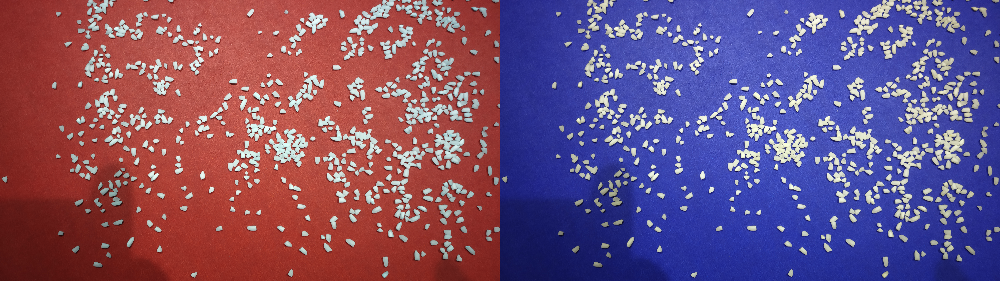



Buffered data was truncated after reaching the output size limit.

In [ ]:
for url in urls:
  image=io.imread(url)
  
  image_2=cv.cvtColor(image,cv.COLOR_BGR2RGB)
  final_frame = cv.hconcat((image, image_2))
  cv2_imshow(final_frame)
  print('\n')

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving full_grain_1.jpg to full_grain_1.jpg


In [ ]:
# Check the image matrix data type (could know the bit depth of the image)
print(image.dtype)
# Check the height of image 
print(image.shape[0])
# Check the width of image 
print(image.shape[1])
# Check the number of channels of the image
print(image.shape[2])

uint8
2250
3474
3


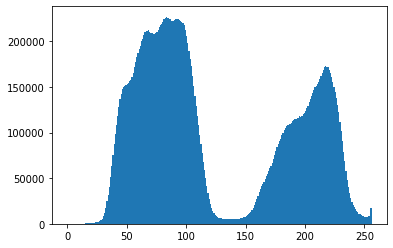

In [ ]:
plt.hist(image.ravel(),bins = 256, range = [0,256]) 
plt.show()

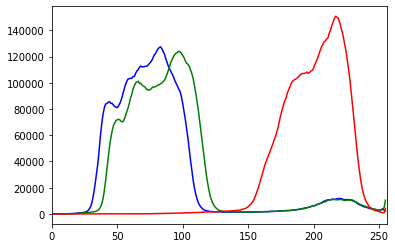

In [ ]:
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist([image],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

In [ ]:
gray_image = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
cv2_imshow(gray_image)

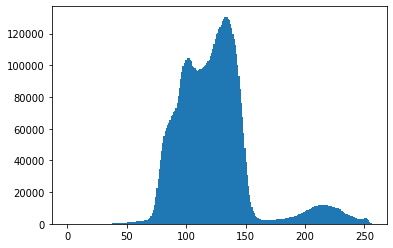

In [ ]:
# Plot the histogram of the gray image. We could observe that the frequency of
# the image hist has decreased ~ 1/3 of the histogram of color image
plt.hist(gray_image.ravel(),bins = 256, range = [0, 256])
plt.show()

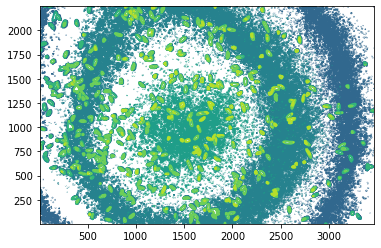

In [ ]:
plt.contour(gray_image, origin = "image")

In [ ]:
# Set threshold for the countour detection
ret, thresh = cv.threshold(gray_image,150,255,0)


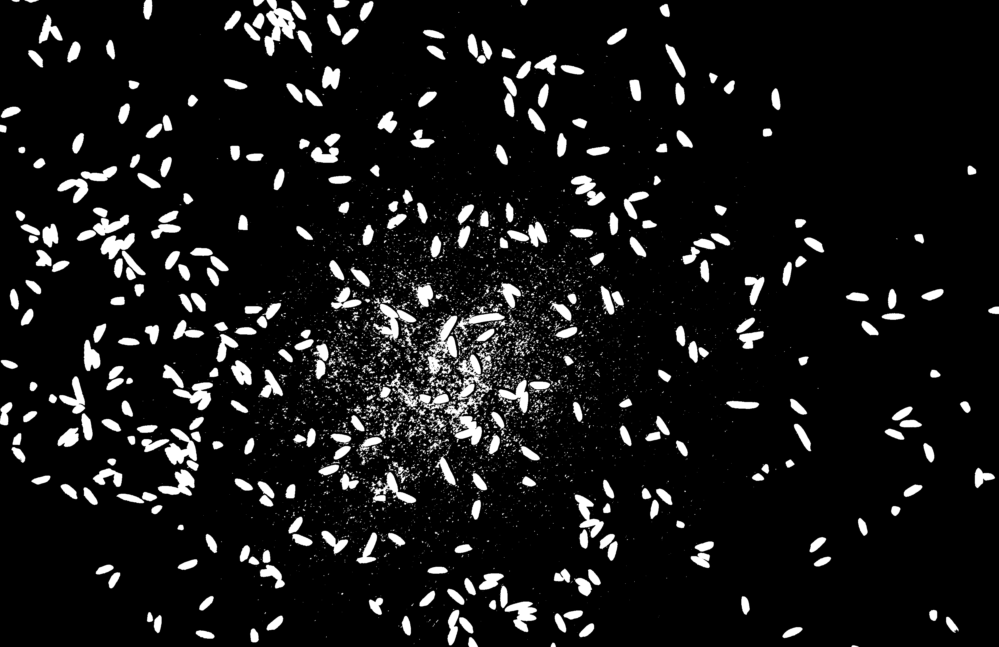

-1

In [ ]:
cv2_imshow(thresh)
cv2.waitKey(0)

In [ ]:
kernel=np.ones((3,3),np.uint8)
eroded=cv2.erode(thresh,kernel,iterations=1)

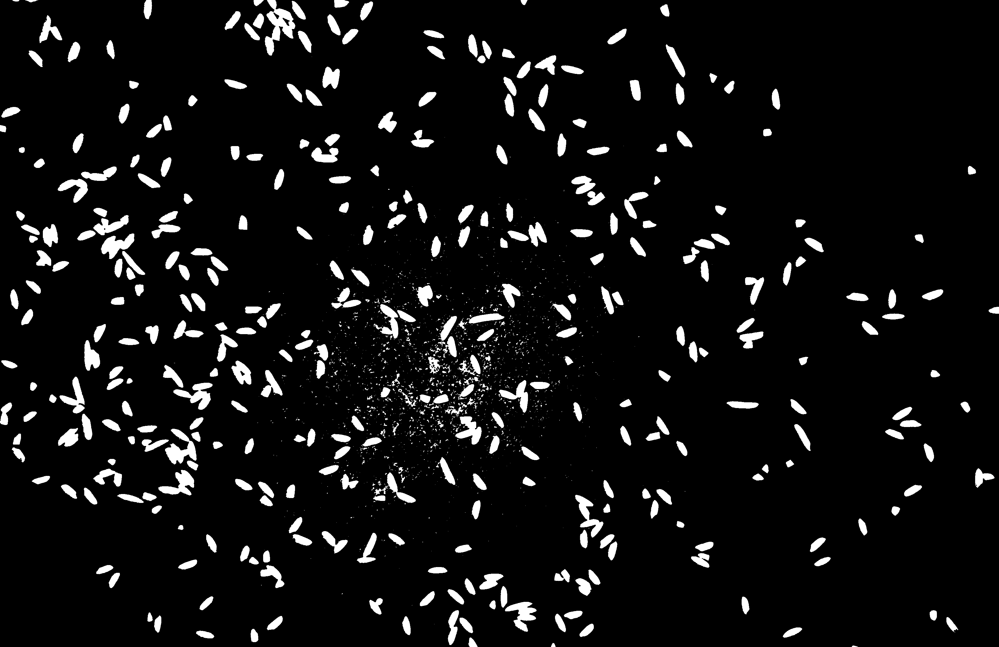

-1

In [ ]:
cv2_imshow(eroded)
cv2.waitKey(0)

In [ ]:
dilated=cv2.dilate(eroded,kernel,iterations=1)

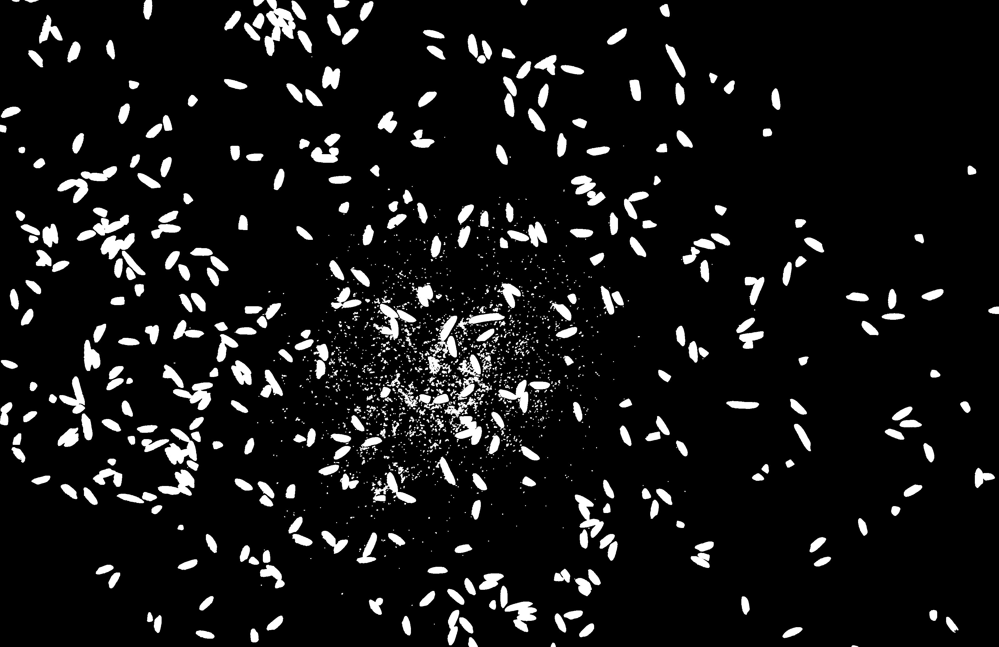

-1

In [ ]:
cv2_imshow(dilated)
cv2.waitKey(0)

In [ ]:
mask=dilated==255

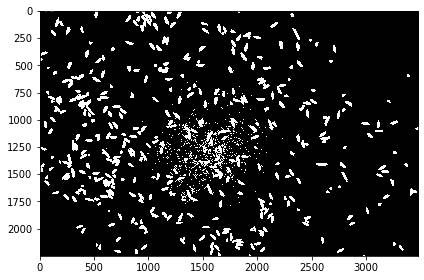

In [ ]:
io.imshow(mask)

In [ ]:
mask

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [ ]:
s=(1,1,1), (1,1,1), (1,1,1)
labeled_mask,num_labels=ndimage.label(mask, structure=s)

In [ ]:
labeled_mask

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int32)

In [ ]:
num_labels

1917

In [ ]:
clusters=measure.regionprops(labeled_mask, thresh)

In [ ]:
for prop in clusters:
 print('Label:{} Area:{}'.format(prop.label,prop.area))

Label:1 Area:141
Label:2 Area:269
Label:3 Area:1705
Label:4 Area:565
Label:5 Area:9699
Label:6 Area:1238
Label:7 Area:351
Label:8 Area:1776
Label:9 Area:1949
Label:10 Area:1120
Label:11 Area:1965
Label:12 Area:1473
Label:13 Area:2029
Label:14 Area:3565
Label:15 Area:1653
Label:16 Area:1961
Label:17 Area:1827
Label:18 Area:1438
Label:19 Area:2107
Label:20 Area:2019
Label:21 Area:1381
Label:22 Area:1398
Label:23 Area:2124
Label:24 Area:3013
Label:25 Area:1622
Label:26 Area:1143
Label:27 Area:1601
Label:28 Area:2881
Label:29 Area:686
Label:30 Area:9
Label:31 Area:1778
Label:32 Area:1739
Label:33 Area:3645
Label:34 Area:678
Label:35 Area:1788
Label:36 Area:1769
Label:37 Area:2286
Label:38 Area:818
Label:39 Area:1133
Label:40 Area:1882
Label:41 Area:1911
Label:42 Area:2028
Label:43 Area:1721
Label:44 Area:1900
Label:45 Area:1957
Label:46 Area:2042
Label:47 Area:970
Label:48 Area:1914
Label:49 Area:1694
Label:50 Area:2470
Label:51 Area:2934
Label:52 Area:1312
Label:53 Area:1171
Label:54 Area